# DIGHUM101: Sexual Health Education
#### by Megane Tchatchouang

# Abstract

## Introduction

Sexual Health Education was first formally introduced to American schools in the 1910s. More than 100 years later, it continues to be a hot topic; not just within schools, but in the larger societal sphere. In fact, many laws on sexual health are based on the lessons students are taught in their sex-ed courses (whether they are misconceptions or not). But can we say we have progressed in the way sexual health education is taught in schools? What has changed (positively or negatively) and what do we need to do better? 

## Research Question

Through this project, I aim to analyze how modern (~ 2022) sexual health education differs in comparison to the education provided a century (~1922) ago. Which topics in sexual education do they focus on/valued more and what is the tone in which this information was provided?

## Methods

I will be building my analysis through a comparison of textual data between modern sexual health education books & suggested topical lesson plans and the books/suggested lesson plans from a century ago. The methods I will be using include text frequency analysis, POS Tagging, TF-IDF scoring, and a sentiment analysis.

## Resources & Data

To collect my data, I researched for modern text on free e-book stores & researched for older text by diving through the Library of Congress and Internet Archive.

Modern text:

<a href = 'https://usa1lib.org/book/19271167/4ede06'> Sex Education for Boys: A Parent's Guide: Practical Advice on Puberty, Sex, and Relationships
 </a>
 
<a href = 'https://usa1lib.org/book/21764336/06f059'> Losing It: Sex Education for the 21st Century
 </a>
 
<a href = 'https://www.studentachievement.org/wp-content/uploads/Human-Sexuality-Lesson-Plans.pdf'> Modern lesson plan on sex education </a>



Older text:

<a href = 'https://archive.org/details/b20442683/page/n13/mode/2up'>What a young man ought to know</a>

<a href = 'https://archive.org/details/HighSchoolsAndSexEducation'> High schools and sex education A manual of suggestions on education related to sex
</a>

<a href = 'https://www.loc.gov/resource/gdcmassbookdig.educationofyoung00will/?sp=6&st=gallery'>The education of the young in sex hygiene; a textbook for parents and teachers,
</a>

# Procedure

## Import & Install

In [2406]:
import os
import re
import spacy
import string
import math
import random
import json

import nltk
from nltk.corpus import stopwords
from nltk import word_tokenize
from nltk import pos_tag
nltk.download("stopwords")
nltk.download("averaged_perceptron_tagger")
nltk.download("punkt")
nltk.download('omw-1.4')
from nltk.stem import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()
from string import punctuation
from collections import Counter 
from scipy import stats
from wordcloud import WordCloud

#Sentiment Analysis
#import nltk
nltk.download('sentiwordnet')
nltk.download('vader_lexicon')
from nltk.corpus import sentiwordnet as swn

from nltk.sentiment.vader import SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()

#tfidf
from sklearn.feature_extraction.text import TfidfVectorizer

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/meganetchatchouang/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/meganetchatchouang/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package punkt to
[nltk_data]     /Users/meganetchatchouang/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /Users/meganetchatchouang/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package sentiwordnet to
[nltk_data]     /Users/meganetchatchouang/nltk_data...
[nltk_data]   Package sentiwordnet is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/meganetchatchouang/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [2316]:

os.chdir("../Data/")


# 1920s

old_book1 = open("WhatAYoungManOughtToKnow1897.txt", encoding = 'utf-8').read()
old_book2 = open("SexHygiene1913.txt", encoding = 'utf-8').read() 
old_book3 = open("HighSchoolsSexEducation1922.txt", encoding = 'utf-8').read() # 1922 Sex Ed suggested curriculum

# 2020s

new_book1 = open("SexEducationForBoys2022.txt", encoding = 'utf-8').read() 
new_book2 = open("LosingIt2022.txt", encoding = 'utf-8').read() # Sex myth-busting
new_book3 = open("HumanSexualityLessonPlans.txt", encoding = 'utf-8').read() # Modern Sex Ed suggested curriculum

## Text Preprocessing

### Punctuation

Removing the punctuatuin in the text.

In [2317]:
punctuation = '''!()-[]{};:'"\,<>./?@#$%^&*_§¶¢£™¡`~‘’—’•‘»–“”'''

In [2318]:
def no_punc(text):
# Removes all punctuation 
    for char in punctuation:
        text = text.replace(char, "")
    return text

old_book1 = no_punc(old_book1)
old_book2 = no_punc(old_book2)
old_book3 = no_punc(old_book3)

new_book1 = no_punc(new_book1)
new_book2 = no_punc(new_book2)
new_book3 = no_punc(new_book3)

In [2319]:
print(punctuation)

!()-[]{};:'"\,<>./?@#$%^&*_§¶¢£™¡`~‘’—’•‘»–“”


In [2320]:
print(old_book1)
# print(old_book2)
# print(old_book3)
# print(new_book1)
# print(new_book1)
# print(new_book3)

22500275458 



r 



CommenDa 
twits from  
Cmtnent   
cn attD   
domett   



What Eminent Profit in Ambrica Sat 




JOSEPH COOK DD LLD 

The Eminent Scholar Boston Monday Lecturer 
author of  Biology  Marriage  Labor 
 Socialism  Occident  Orient etc 

 Vour book on  What a Young Boy Ought to 
Know  treats its subject with the utmost delicacy 
and lucidity and is severely faithful in its admonitions 
to parents as well as to the young It is everywhere 
suggestive inspiring and strategic in a degree as I 
think not hitherto matched in literature of its class 
Its wide circulation ought to fall on the hearts of the 
young in their thrifty and jubilant vernal season as a 
divine benediction of light and heat and rain 



What Eminent Ie oi ih3 ij America Sat 




THEODORE L CUYLER DD 

The best living writer of devotional literature  former 
pastor of Lafayette Avenue Church Brooklyn  author 
of Christianity in the Home How to be a 
Pastor  Stirring the Eagles Nest 
 Young Preacher et

### Lowercase

Convert the whole text into complete lowercase.

In [1914]:
def lowercase(text):
# Converts string to lowercase
    text = text.lower()
    return text

old_book1 = lowercase(old_book1)
old_book2 = lowercase(old_book2)
old_book3 = lowercase(old_book3)

new_book1 = lowercase(new_book1)
new_book2 = lowercase(new_book2)
new_book3 = lowercase(new_book3)

In [1915]:
print(old_book1)
# print(old_book2)
# print(old_book3)
# print(new_book1)
# print(new_book2)
# print(new_book3)

22500275458 



r 



commenda 
twits from  
cmtnent   
cn attd   
domett   



what eminent profit in ambrica sat 




joseph cook dd lld 

the eminent scholar boston monday lecturer 
author of  biology  marriage  labor 
 socialism  occident  orient etc 

 vour book on  what a young boy ought to 
know  treats its subject with the utmost delicacy 
and lucidity and is severely faithful in its admonitions 
to parents as well as to the young it is everywhere 
suggestive inspiring and strategic in a degree as i 
think not hitherto matched in literature of its class 
its wide circulation ought to fall on the hearts of the 
young in their thrifty and jubilant vernal season as a 
divine benediction of light and heat and rain 



what eminent ie oi ih3 ij america sat 




theodore l cuyler dd 

the best living writer of devotional literature  former 
pastor of lafayette avenue church brooklyn  author 
of christianity in the home how to be a 
pastor  stirring the eagles nest 
 young preacher et

### Tokenization

Tokenize and split up the words in the text.

In [1916]:
old_book1 = word_tokenize(old_book1)
old_book2 = word_tokenize(old_book2)
old_book3 = word_tokenize(old_book3)

new_book1 = word_tokenize(new_book1)
new_book2 = word_tokenize(new_book2)
new_book3 = word_tokenize(new_book3)

In [1917]:
print(old_book1)
# print(old_book2)
# print(old_book3)
# print(new_book1)
# print(new_book2)
# print(new_book3)

['22500275458', 'r', 'commenda', 'twits', 'from', 'cmtnent', 'cn', 'attd', 'domett', 'what', 'eminent', 'profit', 'in', 'ambrica', 'sat', 'joseph', 'cook', 'dd', 'lld', 'the', 'eminent', 'scholar', 'boston', 'monday', 'lecturer', 'author', 'of', 'biology', 'marriage', 'labor', 'socialism', 'occident', 'orient', 'etc', 'vour', 'book', 'on', 'what', 'a', 'young', 'boy', 'ought', 'to', 'know', 'treats', 'its', 'subject', 'with', 'the', 'utmost', 'delicacy', 'and', 'lucidity', 'and', 'is', 'severely', 'faithful', 'in', 'its', 'admonitions', 'to', 'parents', 'as', 'well', 'as', 'to', 'the', 'young', 'it', 'is', 'everywhere', 'suggestive', 'inspiring', 'and', 'strategic', 'in', 'a', 'degree', 'as', 'i', 'think', 'not', 'hitherto', 'matched', 'in', 'literature', 'of', 'its', 'class', 'its', 'wide', 'circulation', 'ought', 'to', 'fall', 'on', 'the', 'hearts', 'of', 'the', 'young', 'in', 'their', 'thrifty', 'and', 'jubilant', 'vernal', 'season', 'as', 'a', 'divine', 'benediction', 'of', 'light'

### Merge Lists

Combine all the old texts together and all the modern texts together.

In [1918]:
old_books = old_book1 + old_book2 + old_book3
new_books = new_book1 + new_book2 + new_book3

In [1919]:
print(old_books)

['22500275458', 'r', 'commenda', 'twits', 'from', 'cmtnent', 'cn', 'attd', 'domett', 'what', 'eminent', 'profit', 'in', 'ambrica', 'sat', 'joseph', 'cook', 'dd', 'lld', 'the', 'eminent', 'scholar', 'boston', 'monday', 'lecturer', 'author', 'of', 'biology', 'marriage', 'labor', 'socialism', 'occident', 'orient', 'etc', 'vour', 'book', 'on', 'what', 'a', 'young', 'boy', 'ought', 'to', 'know', 'treats', 'its', 'subject', 'with', 'the', 'utmost', 'delicacy', 'and', 'lucidity', 'and', 'is', 'severely', 'faithful', 'in', 'its', 'admonitions', 'to', 'parents', 'as', 'well', 'as', 'to', 'the', 'young', 'it', 'is', 'everywhere', 'suggestive', 'inspiring', 'and', 'strategic', 'in', 'a', 'degree', 'as', 'i', 'think', 'not', 'hitherto', 'matched', 'in', 'literature', 'of', 'its', 'class', 'its', 'wide', 'circulation', 'ought', 'to', 'fall', 'on', 'the', 'hearts', 'of', 'the', 'young', 'in', 'their', 'thrifty', 'and', 'jubilant', 'vernal', 'season', 'as', 'a', 'divine', 'benediction', 'of', 'light'

In [1920]:
print(new_books)

['copyright', '©', '2022', 'by', 'rockridge', 'press', 'oakland', 'california', 'no', 'part', 'of', 'this', 'publication', 'may', 'be', 'reproduced', 'stored', 'in', 'a', 'retrieval', 'system', 'or', 'transmitted', 'in', 'any', 'form', 'or', 'by', 'any', 'means', 'electronic', 'mechanical', 'photocopying', 'recording', 'scanning', 'or', 'otherwise', 'except', 'as', 'permitted', 'under', 'sections', '107', 'or', '108', 'of', 'the', '1976', 'united', 'states', 'copyright', 'act', 'without', 'the', 'prior', 'written', 'permission', 'of', 'the', 'publisher', 'requests', 'to', 'the', 'publisher', 'for', 'permission', 'should', 'be', 'addressed', 'to', 'the', 'permissions', 'department', 'rockridge', 'press', '1955', 'broadway', 'suite', '400', 'oakland', 'ca', '94612', 'limit', 'of', 'liabilitydisclaimer', 'of', 'warranty', 'the', 'publisher', 'and', 'the', 'author', 'make', 'no', 'representations', 'or', 'warranties', 'with', 'respect', 'to', 'the', 'accuracy', 'or', 'completeness', 'of', 

### Stop Words

Remove unnecessary stopwords within the texts.

In [1921]:
def no_stops(text):
    no_stops = [word for word in text if word not in stopwords.words('english')]
    return no_stops

In [1922]:
old_book1 = no_stops(old_book1)
old_book2 = no_stops(old_book2)
old_book3 = no_stops(old_book3)
old_books = no_stops(old_books)

new_book1 = no_stops(new_book1)
new_book2 = no_stops(new_book2)
new_book3 = no_stops(new_book3)
new_books = no_stops(new_books)

In [1923]:
print(old_book1)
# print(old_book2)
# print(old_book3)
# print(old_books)
# print(new_book1)
# print(new_book2)
# print(new_book3)
# print(new_books)

['22500275458', 'r', 'commenda', 'twits', 'cmtnent', 'cn', 'attd', 'domett', 'eminent', 'profit', 'ambrica', 'sat', 'joseph', 'cook', 'dd', 'lld', 'eminent', 'scholar', 'boston', 'monday', 'lecturer', 'author', 'biology', 'marriage', 'labor', 'socialism', 'occident', 'orient', 'etc', 'vour', 'book', 'young', 'boy', 'ought', 'know', 'treats', 'subject', 'utmost', 'delicacy', 'lucidity', 'severely', 'faithful', 'admonitions', 'parents', 'well', 'young', 'everywhere', 'suggestive', 'inspiring', 'strategic', 'degree', 'think', 'hitherto', 'matched', 'literature', 'class', 'wide', 'circulation', 'ought', 'fall', 'hearts', 'young', 'thrifty', 'jubilant', 'vernal', 'season', 'divine', 'benediction', 'light', 'heat', 'rain', 'eminent', 'ie', 'oi', 'ih3', 'ij', 'america', 'sat', 'theodore', 'l', 'cuyler', 'dd', 'best', 'living', 'writer', 'devotional', 'literature', 'former', 'pastor', 'lafayette', 'avenue', 'church', 'brooklyn', 'author', 'christianity', 'home', 'pastor', 'stirring', 'eagles',

### Lemmatization

Lemmatize the texts.

In [1924]:
def lemmas(text):
    lemmer = WordNetLemmatizer()
    return [lemmer.lemmatize(text) for text in text] 

In [1925]:
old_book1 = lemmas(old_book1)
old_book2 = lemmas(old_book2)
old_book3 = lemmas(old_book3)
old_books = lemmas(old_books)


new_book1 = lemmas(new_book1)
new_book2 = lemmas(new_book2)
new_book3 = lemmas(new_book3)
new_books = lemmas(new_books)

In [1926]:
print(old_books)
# print(old_book2)
# print(old_book3)
# print(old_books)
# print(new_book1)
# print(new_book2)
# print(new_book3)
# print(new_books)

['22500275458', 'r', 'commenda', 'twit', 'cmtnent', 'cn', 'attd', 'domett', 'eminent', 'profit', 'ambrica', 'sat', 'joseph', 'cook', 'dd', 'lld', 'eminent', 'scholar', 'boston', 'monday', 'lecturer', 'author', 'biology', 'marriage', 'labor', 'socialism', 'occident', 'orient', 'etc', 'vour', 'book', 'young', 'boy', 'ought', 'know', 'treat', 'subject', 'utmost', 'delicacy', 'lucidity', 'severely', 'faithful', 'admonition', 'parent', 'well', 'young', 'everywhere', 'suggestive', 'inspiring', 'strategic', 'degree', 'think', 'hitherto', 'matched', 'literature', 'class', 'wide', 'circulation', 'ought', 'fall', 'heart', 'young', 'thrifty', 'jubilant', 'vernal', 'season', 'divine', 'benediction', 'light', 'heat', 'rain', 'eminent', 'ie', 'oi', 'ih3', 'ij', 'america', 'sat', 'theodore', 'l', 'cuyler', 'dd', 'best', 'living', 'writer', 'devotional', 'literature', 'former', 'pastor', 'lafayette', 'avenue', 'church', 'brooklyn', 'author', 'christianity', 'home', 'pastor', 'stirring', 'eagle', 'nest

### POS Tagging

I used Parts-Of-Speech tagging to ensure that word frequency would take into consideration different possible definitions of one specific word.

In [1927]:
old_book1 = pos_tag(old_book1)
old_book2 = pos_tag(old_book2)
old_book3 = pos_tag(old_book3)
old_books = pos_tag(old_books)

new_book1 = pos_tag(new_book1)
new_book2 = pos_tag(new_book2)
new_book3 = pos_tag(new_book3)
new_books = pos_tag(new_books)

In [1928]:
print(old_books)

[('22500275458', 'CD'), ('r', 'NN'), ('commenda', 'NN'), ('twit', 'NN'), ('cmtnent', 'NN'), ('cn', 'NN'), ('attd', 'NN'), ('domett', 'JJ'), ('eminent', 'JJ'), ('profit', 'NN'), ('ambrica', 'NN'), ('sat', 'VBD'), ('joseph', 'NN'), ('cook', 'NN'), ('dd', 'NN'), ('lld', 'JJ'), ('eminent', 'JJ'), ('scholar', 'NN'), ('boston', 'NN'), ('monday', 'NN'), ('lecturer', 'NN'), ('author', 'NN'), ('biology', 'NN'), ('marriage', 'NN'), ('labor', 'NN'), ('socialism', 'NN'), ('occident', 'JJ'), ('orient', 'NN'), ('etc', 'FW'), ('vour', 'FW'), ('book', 'NN'), ('young', 'JJ'), ('boy', 'NN'), ('ought', 'MD'), ('know', 'VB'), ('treat', 'NN'), ('subject', 'JJ'), ('utmost', 'JJ'), ('delicacy', 'NN'), ('lucidity', 'NN'), ('severely', 'RB'), ('faithful', 'JJ'), ('admonition', 'NN'), ('parent', 'NN'), ('well', 'RB'), ('young', 'JJ'), ('everywhere', 'RB'), ('suggestive', 'JJ'), ('inspiring', 'VBG'), ('strategic', 'JJ'), ('degree', 'NN'), ('think', 'VBP'), ('hitherto', 'NN'), ('matched', 'VBN'), ('literature', '

In [1929]:
print(new_books)

[('copyright', 'NN'), ('©', 'NN'), ('2022', 'CD'), ('rockridge', 'NN'), ('press', 'NN'), ('oakland', 'NN'), ('california', 'NN'), ('part', 'NN'), ('publication', 'NN'), ('may', 'MD'), ('reproduced', 'VB'), ('stored', 'VBN'), ('retrieval', 'NN'), ('system', 'NN'), ('transmitted', 'VBD'), ('form', 'JJ'), ('mean', 'JJ'), ('electronic', 'JJ'), ('mechanical', 'JJ'), ('photocopying', 'VBG'), ('recording', 'VBG'), ('scanning', 'VBG'), ('otherwise', 'RB'), ('except', 'IN'), ('permitted', 'VBN'), ('section', 'NN'), ('107', 'CD'), ('108', 'CD'), ('1976', 'CD'), ('united', 'JJ'), ('state', 'NN'), ('copyright', 'NN'), ('act', 'NN'), ('without', 'IN'), ('prior', 'JJ'), ('written', 'VBN'), ('permission', 'NN'), ('publisher', 'NN'), ('request', 'NN'), ('publisher', 'NN'), ('permission', 'NN'), ('addressed', 'VBD'), ('permission', 'NN'), ('department', 'NN'), ('rockridge', 'NN'), ('press', 'NN'), ('1955', 'CD'), ('broadway', 'NN'), ('suite', 'JJ'), ('400', 'CD'), ('oakland', 'NN'), ('ca', 'MD'), ('946

### Unique Words

In [1930]:
def unique(text):
    return (set(text))

uni_old_book1 = unique(old_book1)
uni_old_book2 = unique(old_book2)
uni_old_book3 = unique(old_book3)
uni_old_books = unique(old_books)

uni_new_book1 = unique(new_book1)
uni_new_book2 = unique(new_book2)
uni_new_book3 = unique(new_book3)
uni_new_books = unique(new_books)

In [1931]:
len(uni_old_books)

18555

In [1932]:
len(uni_new_books)

13132

In [1933]:
print("There are " + str(len(uni_old_book1)) + " unique words in Old Book 1")
print("There are " + str(len(uni_old_book2)) + " unique words in Old Book 2")
print("There are " + str(len(uni_old_book3)) + " unique words in Old Book 3")
print("There are " + str(len(uni_old_books)) + " unique words total in all Old Books.")
print("")
print("There are " + str(len(uni_new_book1)) + " unique words in New Book 1")
print("There are " + str(len(uni_new_book2)) + " unique words in New Book 2")
print("There are " + str(len(uni_new_book3)) + " unique words in New Book 3")
print("There are " + str(len(uni_new_books)) + " unique words total in all New Books.")

There are 5405 unique words in Old Book 1
There are 13635 unique words in Old Book 2
There are 6192 unique words in Old Book 3
There are 18555 unique words total in all Old Books.

There are 5571 unique words in New Book 1
There are 8909 unique words in New Book 2
There are 3549 unique words in New Book 3
There are 13132 unique words total in all New Books.


### Word Frequencies

Count the frequencies of each word within the texts.

In [6]:
def freq(text):
    return Counter(text)

In [1935]:
freq_old_book1 = freq(old_book1)
freq_old_book2 = freq(old_book2)
freq_old_book3 = freq(old_book3)
freq_old_books = freq(old_books)

freq_new_book1 = freq(new_book1)
freq_new_book2 = freq(new_book2)
freq_new_book3 = freq(new_book3)
freq_new_books = freq(new_books)

In [1936]:
print(freq_old_books.most_common)

<bound method Counter.most_common of Counter({('sex', 'NN'): 898, ('boy', 'NN'): 803, ('one', 'CD'): 677, ('disease', 'NN'): 635, ('life', 'NN'): 591, ('woman', 'NN'): 543, ('may', 'MD'): 522, ('upon', 'IN'): 515, ('girl', 'NN'): 508, ('child', 'NN'): 505, ('school', 'NN'): 473, ('many', 'JJ'): 454, ('young', 'JJ'): 418, ('must', 'MD'): 397, ('man', 'NN'): 394, ('home', 'NN'): 381, ('body', 'NN'): 374, ('time', 'NN'): 369, ('physical', 'JJ'): 360, ('every', 'DT'): 358, ('would', 'MD'): 356, ('year', 'NN'): 351, ('men', 'NNS'): 348, ('social', 'JJ'): 334, ('mother', 'NN'): 320, ('health', 'NN'): 319, ('education', 'NN'): 317, ('even', 'RB'): 292, ('chapter', 'NN'): 278, ('fact', 'NN'): 253, ('public', 'JJ'): 245, ('parent', 'NN'): 244, ('part', 'NN'): 240, ('high', 'JJ'): 239, ('also', 'RB'): 238, ('new', 'JJ'): 234, ('moral', 'JJ'): 233, ('case', 'NN'): 228, ('little', 'JJ'): 219, ('infection', 'NN'): 213, ('form', 'NN'): 212, ('boy', 'JJ'): 210, ('way', 'NN'): 205, ('know', 'VB'): 200

In [1937]:
print(freq_new_books)

Counter({('sex', 'NN'): 763, ('sexual', 'JJ'): 648, ('woman', 'NN'): 551, ('one', 'CD'): 405, ('relationship', 'NN'): 350, ('people', 'NNS'): 350, ('men', 'NNS'): 312, ('time', 'NN'): 306, ('like', 'IN'): 286, ('son', 'NN'): 268, ('may', 'MD'): 249, ('also', 'RB'): 225, ('would', 'MD'): 222, ('life', 'NN'): 217, ('lesson', 'NN'): 213, ('many', 'JJ'): 199, ('way', 'NN'): 193, ('might', 'MD'): 189, ('gender', 'NN'): 186, ('young', 'JJ'): 185, ('group', 'NN'): 181, ('health', 'NN'): 176, ('even', 'RB'): 173, ('question', 'NN'): 169, ('help', 'NN'): 168, ('could', 'MD'): 164, ('plan', 'NN'): 161, ('experience', 'NN'): 160, ('virginity', 'NN'): 158, ('sexuality', 'NN'): 156, ('want', 'VBP'): 155, ('body', 'NN'): 153, ('education', 'NN'): 152, ('make', 'VBP'): 150, ('social', 'JJ'): 149, ('thing', 'NN'): 148, ('part', 'NN'): 146, ('school', 'NN'): 144, ('year', 'NN'): 142, ('someone', 'NN'): 138, ('partner', 'NN'): 136, ('use', 'NN'): 135, ('consent', 'NN'): 133, ('age', 'NN'): 127, ('know',

## Analysis & Visualization

Below is a sexual health glossary. It's a colletion of important words that are commonly used when duscussing sexual health. To collect this, I used words from <a href = 'https://www.plannedparenthood.org/learn/glossary#id_S'> Planned Parenthood's sexual health glossary</a> and <a href = 'https://advocatesforyouth.org/wp-content/uploads/2019/09/NSES-Glossary.pdf'> Advocates for Youth's Sex Education Glossary</a>. This glossary is conscious of important topics when discussing sexual health such as queerness, intersectionality, oppression, advocacy, and descriptive anatomy.

### Sex-Ed Glossary

In [2025]:
sex_glossary = ["abort", "ableism", "ableist", "abstain", "abstinen", "abuse", "abusive", "addict", "adolescen", "adopt", "advocate", "afterbirth", "agency", "agender", "aids", "ally", "anal", "anatomy", "androgen", "androgynous", "anus", "asexual", "areola", "arous", "assault", "autonomy", "bdsm", "bias", "bigender", "binary", "biological", "biopsy", "biphob", "birth", "bisexual", "body", "boner", "boundar", "breast", "bully", "c-section", "celiba", "cervical", "cervix", "chest", "child", "chlmaydia", "choice", "circumcis", "cis", "classis", "clitoris", "community","coerc", "conception", "condom", "consent", "contraception", "contraceptive", "cultural", "cum", "cycle", "dating", "disab", "discharge", "disease", "diversity", "domestic", "drag", "dysphoria", "ejaculat", "embryo", "endometriosis", "epidural", "equality", "equity", "erect", "erotic", "estrogen", "eugenics", "exploit", "expression", "family", "fatphob", "female", "feminin", "feminis", "fertil", "fetus", "foreplay", "foreskin", "gaslight", "gay", "gender", "genes", "genital", "gonads", "gonhorrea", "gynecolog", "harass", "hetero", "herpes", "hiv", "homo", "hormon", "horny", "hpv", "hymen", "identity", "implant", "incest", "inclus", "infect", "infertil", "insemin", "intercourse", "interpersonal", "intersectional", "intersex", "intima", "justice", "kink", "labia", "labor", "lesbian", "lgbtq", "lube", "lubricant", "lust", "male", "man", "marital", "marriage", "masculine", "masturbat", "maternal", "men", "menopause", "menorrhagia", "menses", "menstrual", "miscarriage", "misgender", "misogyn", "monogamy", "nipple", "nonbinary", "nonconforming", "oral", "orientation", "orgasm", "outing", "ovar", "ovulat", "pansexual", "partner", "pelvic", "penetrat", "penis", "period", "phallic", "pheromon", "placenta", "plan-b", "pms", "premenstrual", "polyamor", "polygam", "porn", "postparum", "power", "pregnan", "prep", "privilege", "progestorone", "promiscuous", "pronoun", "prostate", "puberty", "queer", "questioning", "race", "racial", "racism", "rape", "rectum", "relationship", "reproductive", "risk", "safe", "sanitary", "scrotum", "sexis", "minorit", "sexuality", "sodomy", "sperm", "std", "stereotype", "steril", "stigma", "straight", "systemic", 'syphil', "taboo", "testes", "testicles", "testosterone", "therapy", "traffick", "transition", "transmit", "transgender", "transphob", "trauma", "ultrasound", "uncircumcised", "urethra", "uterus", "uti", "vagina", "vaginismus", "vaginitis", "vibrator", "violen", "viral", "virgin", "voyeurism", "vulva", "woman", "women", "zygote"]

In [2026]:
len(sex_glossary)

232

In [2027]:
print(sex_glossary)

['abort', 'ableism', 'ableist', 'abstain', 'abstinen', 'abuse', 'abusive', 'addict', 'adolescen', 'adopt', 'advocate', 'afterbirth', 'agency', 'agender', 'aids', 'ally', 'anal', 'anatomy', 'androgen', 'androgynous', 'anus', 'asexual', 'areola', 'arous', 'assault', 'autonomy', 'bdsm', 'bias', 'bigender', 'binary', 'biological', 'biopsy', 'biphob', 'birth', 'bisexual', 'body', 'boner', 'boundar', 'breast', 'bully', 'c-section', 'celiba', 'cervical', 'cervix', 'chest', 'child', 'chlmaydia', 'choice', 'circumcis', 'cis', 'classis', 'clitoris', 'community', 'coerc', 'conception', 'condom', 'consent', 'contraception', 'contraceptive', 'cultural', 'cum', 'cycle', 'dating', 'disab', 'discharge', 'disease', 'diversity', 'domestic', 'drag', 'dysphoria', 'ejaculat', 'embryo', 'endometriosis', 'epidural', 'equality', 'equity', 'erect', 'erotic', 'estrogen', 'eugenics', 'exploit', 'expression', 'family', 'fatphob', 'female', 'feminin', 'feminis', 'fertil', 'fetus', 'foreplay', 'foreskin', 'gaslight

While analyzing the data, I noticed some words, that were unrelated to sexual health showed up because they partly contained words included in the sex glossary. I collected those words into a list to easily filter them out. 

In [1941]:
irr= str("abdomen abdomens acknowledgements adjustment adjustments advertisement ailment ailments amusement amusements appointment appointments argument arguments arrangement chapman cise command commend comment comments commented commenting commitments comprehensive conception consciousness consignment constituting constitution contributions criticism criticisms decisionmaking demand demands demanded department departments detrimental developmental disagreement disappointment dutchmans duties elements embody embrace empowered environment environments environmental equally equipment establishment experimental experimentation expression expressions filament filaments fulfillment government governments historically illustrated illustrating implanted institutional instrument instruments intrinsically involvement involvements judgement judgements laboratory legally managed management managements manifestation manifestations  manifested manipulation manufacture manufactured manycelled mention mentions mentioned misconception misconceptions movement movements naturally normally permanent permanently personally personally phenomena physically positive positively potentially precisely preparation preparations  preparing rapper recommendation recommendations recommended recommends requirement requirements romantically routine routines specimen specimens statement statements straightforward supplement supplemented technically traceable treatment typically unconditionally  unconsciousness unprepared valued virginia wassermann")
irr_split=str.split(irr)
print(irr_split)

['abdomen', 'abdomens', 'acknowledgements', 'adjustment', 'adjustments', 'advertisement', 'ailment', 'ailments', 'amusement', 'amusements', 'appointment', 'appointments', 'argument', 'arguments', 'arrangement', 'chapman', 'cise', 'command', 'commend', 'comment', 'comments', 'commented', 'commenting', 'commitments', 'comprehensive', 'conception', 'consciousness', 'consignment', 'constituting', 'constitution', 'contributions', 'criticism', 'criticisms', 'decisionmaking', 'demand', 'demands', 'demanded', 'department', 'departments', 'detrimental', 'developmental', 'disagreement', 'disappointment', 'dutchmans', 'duties', 'elements', 'embody', 'embrace', 'empowered', 'environment', 'environments', 'environmental', 'equally', 'equipment', 'establishment', 'experimental', 'experimentation', 'expression', 'expressions', 'filament', 'filaments', 'fulfillment', 'government', 'governments', 'historically', 'illustrated', 'illustrating', 'implanted', 'institutional', 'instrument', 'instruments', '

In [1942]:
irrelevant = ["accomplishment", "achievement", "actually", "analyze", "adjust", "advertisements", "agreement", "aliment", "automatically", "immoral", "emotionally", "amenable", "analysis", "annually", "arguement", "automatic", "beautiful", "beautifully", "birthday", "cally", "chapman","scrutinise", "canal", "caution", "chivalry", "cially", "circumstance", "circumstances", "collaborate", "collaboration", "commitment", "constitute", "contribution", "crtically", "decision", "dementia", "detriment", "development", "disgrace", "distribute", "distribution", "dormant", "effect", "effectually", "element", "elementary", "embarrassment", "embracement", "employment", "encouragement", "enforcement", "enjoyment", "enlightenment", "entertainment", "especially", "essentially", "eventually", "everybody", "evolution", "excitement", "execute", "execution", 'executive', "exercise", "experiment", "finally", "francis", "fundament", "fundamental", "generally", "genesis", "german", "germany", "grace", "gradually", "grape", "human", "humanity", "humans", "illustrate", "illustrates", "illustration", "illustrations", "implement", "implements", "improvement", "improvements", "kollmann", "literally", "logically", "maids", "manage", "manifest", "manner", "manners", 'manually', "manufature", "manufacturer" , "manufacturers", "many", "menace", "mendels", "mentality", "mentally", "moment", "moments", "moral", "morally", "morality", "mutually", " normally", "nourishment", "occasionally", "offiially", "originally", "ornament", "ornaments", "partially", "performance", "perpetually", "practicality", "practically", "prepatory", "prepare", "prepared", "promiscuous", "punishment", "really", "recommend", "regelement", "requirrement", "revolution", "roman", "romans", "scrutinize", "scrutiny", "sentiment", "manual", "nobody", "decisions", "deision", "solution", "solutions", "specially", "specifically", "straightway", "supplements", "supplementary", "sylvanus", "technical", "temperament", "totally", "trace", "tuition", "tution", "unconscious", "university", "usually", "utilization", "utilized", "value", "values", "velopment", "virtually", "vitally", "wasserman", 'abdomen', 'adjustment', 'adjustments', 'advertisement', 'ailment', 'ailments', 'amusement', 'amusements', 'appointment', 'appointments', 'argument', 'cise', 'command', 'commend', 'comment', 'comments', 'commented', 'commenting', 'commitments', 'comprehensive', 'consciousness', 'constitution', 'contributions', 'criticism', 'criticisms', 'decisionmaking', 'demand', 'demands', 'department', 'departments', 'detrimental', 'developmental', 'disagreement', 'disappointment', 'duties', 'elements', 'embody', 'embrace', 'empowered', 'environment', 'environments', 'equally', 'equipment', 'establishment', 'experimental', 'filament', 'filaments', 'fulfillment', 'government', 'governments', 'historically', 'illustrated', 'illustrating', 'institutional', 'instrument', 'instruments', 'intrinsically', 'involvements', 'judgement', 'judgements', 'laboratory', 'legally', 'managed', 'management', 'managements', 'manifestation', 'manifestations', 'manifested', 'manipulation', 'manufacture', 'manufactured', 'manycelled', 'mention', 'mentions', 'mentioned', 'misconception', 'misconceptions', 'movement', 'movements', 'naturally', 'normally', 'permanent', 'permanently', 'phenomena', 'physically', 'positive', 'positively', 'potentially', 'preparation', "involvement", "implanted", "precisely", "expressions", "dutchmans", "consignment", "constituting", "statements", "arrangement", "preparatory", "demanded", "arguments", "personally", "meningitis", "abdomens", "traceable", "preparations", "acknowledgments", "unconsciously", "universally", "traced", "manifestly", "exercised", "officially", "ment", "acknowledgements", "environmental", "recommended", "experimentation", 'preparing', 'rapeer', 'recommendation', 'recommendations', 'recommends', 'requirement', 'requirements', 'romantically', 'routine', 'routines', 'specimen', 'specimens', 'statement', 'straightforward', 'supplement', 'supplemented', 'technically', 'treatment', 'typically', 'unconditionally', 'unconsciousness', 'unprepared', 'valued', 'virginia', 'wassermann', 'endowment', ' investment', 'commendation', 'clergyman', 'judgment', 'ments', 'acknowledgment', 'nonjudgmentally', 'mendel', 'dutchman']

In [1943]:
freq(irrelevant)

Counter({'accomplishment': 1,
         'achievement': 1,
         'actually': 1,
         'analyze': 1,
         'adjust': 1,
         'advertisements': 1,
         'agreement': 1,
         'aliment': 1,
         'automatically': 1,
         'immoral': 1,
         'emotionally': 1,
         'amenable': 1,
         'analysis': 1,
         'annually': 1,
         'arguement': 1,
         'automatic': 1,
         'beautiful': 1,
         'beautifully': 1,
         'birthday': 1,
         'cally': 1,
         'chapman': 1,
         'scrutinise': 1,
         'canal': 1,
         'caution': 1,
         'chivalry': 1,
         'cially': 1,
         'circumstance': 1,
         'circumstances': 1,
         'collaborate': 1,
         'collaboration': 1,
         'commitment': 1,
         'constitute': 1,
         'contribution': 1,
         'crtically': 1,
         'decision': 1,
         'dementia': 1,
         'detriment': 1,
         'development': 1,
         'disgrace': 1,
         'distrib

### Length of Books

To understand future results in word frequency, I found the length of the texts so the results of my word frequency analysis would take into consideration whether a word appeared more frequently due to the length of the book. Using this ratio, I can build a more comprehensive analysis of the data.

In [1944]:
print("Length of Old Book 1: " + str(len(old_book1)))
print("Length of Old Book 2: " + str(len(old_book2)))
print("Length of Old Book 3: " + str(len(old_book3)))
print("Length of all Old Books: " + str(len(old_books)))
print("")
print("Length of New Book 1: " + str(len(new_book1)))
print("Length of New Book 2: " + str(len(new_book2)))
print("Length of New Book 3: " + str(len(new_book3)))
print("Length of all New Books: " + str(len(new_books)))

Length of Old Book 1: 18290
Length of Old Book 2: 65028
Length of Old Book 3: 23328
Length of all Old Books: 106646

Length of New Book 1: 19735
Length of New Book 2: 30671
Length of New Book 3: 14736
Length of all New Books: 65142


In [1945]:
1 - len(new_books)/(len(old_books))

0.38917540273427975

The older texts are about 39% longer total than the modern texts.

### Data Cleaning

In [1946]:
pd.set_option("display.max_rows", None, "display.max_columns", None)

Here, I create dataframes of the words that include part-of-speech and are ordered according to most frequent words.

In [1947]:
def pos_df(text):
    df = pd.DataFrame(df['Word'].to_list(), columns = ['Word', 'POS'])
    return df

In [1948]:
def freq_df(text):
    # Converts text frequencies into a dataframe
    df1 = pd.DataFrame(text, columns = ['Words', 'Frequency'])
    df2 = pd.DataFrame(df1['Words'].to_list(), columns = ['Word', 'POS'])
    df = pd.concat([df1, df2], axis=1)
    df = df.drop('Words', axis=1)
    return df[['Word', 'POS', 'Frequency']]

In [1949]:
df_old_book1 = freq_df(freq_old_book1.most_common(1000))
df_old_book2 = freq_df(freq_old_book2.most_common(1000))
df_old_book3 = freq_df(freq_old_book3.most_common(1000))
df_old_books = freq_df(freq_old_books.most_common(10000))

df_new_book1 = freq_df(freq_new_book1.most_common(1000))
df_new_book2 = freq_df(freq_new_book2.most_common(1000))
df_new_book3 = freq_df(freq_new_book3.most_common(1000))
df_new_books = freq_df(freq_new_books.most_common(10000))

In [1950]:
df_old_books

,Word,POS,Frequency
0,sex,NN,898
1,boy,NN,803
2,one,CD,677
3,disease,NN,635
4,life,NN,591
5,woman,NN,543
6,may,MD,522
7,upon,IN,515
8,girl,NN,508
9,child,NN,505


In [1951]:
df_new_books

,Word,POS,Frequency
0,sex,NN,763
1,sexual,JJ,648
2,woman,NN,551
3,one,CD,405
4,relationship,NN,350
5,people,NNS,350
6,men,NNS,312
7,time,NN,306
8,like,IN,286
9,son,NN,268


Dataframes of most common words in each book. 

In [1952]:
def filter(df, x, y):
    z = ''
    # Filter dataframe text according to words containing string x, then removing y words.
    for i in x:
        z += i + '|'
    filter1 = df["Word"].str.contains(z[:-1])
    filter2 = ~df['Word'].isin(y)
    return df[filter1 & filter2]

Filter the dataframes according to the sex-ed glossary, and removing irrelevant words.

In [1992]:
fil_new_books = filter(df_new_books, sex_glossary, irrelevant)
n = fil_new_books[fil_new_books['Frequency']>=3]
print(fil_new_books['Frequency'].sum())
print(x['Frequency'].sum())

6950
6293


"n" is the filtered dataframe of new books & "o" is the filtered data frame of old books where the word frequency is at least 3. This threshold is low to account for the fact that many words can be spelled differently due  to changes in language or inaccurate words in tokenization or txt files.

In [1993]:
n

,Word,POS,Frequency
2,woman,NN,551
4,relationship,NN,350
6,men,NNS,312
18,gender,NN,186
28,virginity,NN,158
29,sexuality,NN,156
31,body,NN,153
40,partner,NN,136
42,consent,NN,133
69,abortion,NN,94


In [1994]:
fil_old_books = filter(df_old_books, sex_glossary,irrelevant)
o = fil_old_books[fil_old_books['Frequency']>=3]
print(fil_old_books['Frequency'].sum())
print(o['Frequency'].sum())

6665
6366


In [1995]:
o

,Word,POS,Frequency
3,disease,NN,635
5,woman,NN,543
9,child,NN,505
14,man,NN,394
16,body,NN,374
22,men,NNS,348
39,infection,NN,213
51,power,NN,171
79,syphilis,NN,142
94,child,JJ,129


In [1]:
1 - (6665/6950)

0.041007194244604306

While the older text is about 39% longer, the modern text still had 4% more frequent sexual health related words than the older text.



Below are visualizations of comparisons of the filtered dataframes of both modern & old text.

In [1998]:
fil_old_book1 = filter(df_old_book1, sex_glossary,irrelevant)
fil_old_book2 = filter(df_old_book2, sex_glossary,irrelevant)
fil_old_book3 = filter(df_old_book3, sex_glossary,irrelevant)

tot_old_book1 = fil_old_book1['Frequency'].sum()
tot_old_book2 = fil_old_book2['Frequency'].sum()
tot_old_book3 = fil_old_book3['Frequency'].sum()

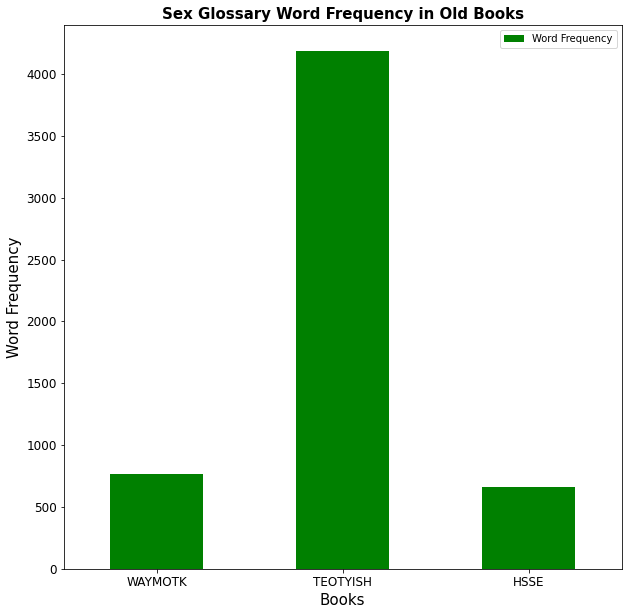

In [2304]:
# compare frequency word distribution between old books

x_vals = ['WAYMOTK', 'TEOTYISH', 'HSSE']
y_vals = [tot_old_book1, tot_old_book2, tot_old_book3]

df = pd.DataFrame({'Book':x_vals, 'Word Frequency':y_vals})
plot_freq = df.plot.bar(x = 'Book',
                             y='Word Frequency',
                             figsize = (10,10),
                             rot=0, color = 'green')

plt.title('Sex Glossary Word Frequency in Old Books', fontweight='bold', fontsize = '15')
    
#Add x and y labels
plt.xlabel('Books', fontsize = '15')
plt.xticks(fontsize=12)
plt.ylabel('Word Frequency', fontsize = '15')
plt.yticks(fontsize=12)
plt.legend()
plt.show()

A comparison word frequency of the older text. "The education of the young in sex hygiene" by far had the most words that appeared in the sex glossary. Part of this reason is likely because it is much longer than the other books.

In [2000]:
fil_new_book1 = filter(df_new_book1, sex_glossary,irrelevant)
fil_new_book2 = filter(df_new_book2, sex_glossary,irrelevant)
fil_new_book3 = filter(df_new_book3, sex_glossary,irrelevant)

tot_new_book1 = fil_new_book1['Frequency'].sum()
tot_new_book2 = fil_new_book2['Frequency'].sum()
tot_new_book3 = fil_new_book3['Frequency'].sum()

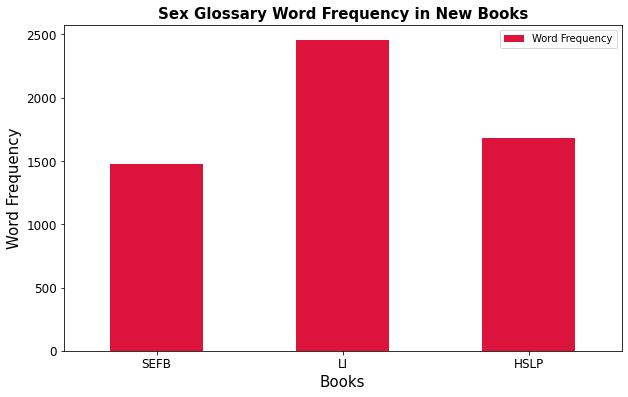

In [2303]:
# compare frequency word distribution between new books

x_vals = ['SEFB', 'LI', 'HSLP']
y_vals = [tot_new_book1, tot_new_book2, tot_new_book3]

df = pd.DataFrame({'Book':x_vals, 'Word Frequency':y_vals})
plot_freq = df.plot.bar(x = 'Book',
                             y='Word Frequency',
                             figsize = (10,6),
                             rot=0,
                             color = 'crimson')

plt.title('Sex Glossary Word Frequency in New Books', fontweight='bold', fontsize = '15')
    
#Add x and y labels
plt.xlabel('Books', fontsize = '15')
plt.xticks(fontsize=12)
plt.ylabel('Word Frequency', fontsize = '15')
plt.yticks(fontsize=12)
plt.legend()
plt.show()

A comparison word frequency of the modern text. "Losing It: Sex Education for the 21st Century" had more words that appeared in the sex glossary. It is also likely because it is longer than the other books.

In [2002]:
fil_old_books = filter(df_old_books, sex_glossary, irrelevant)
fil_new_books = filter(df_new_books, sex_glossary, irrelevant)

tot_old_books = fil_old_books['Frequency'].sum()
tot_new_books = fil_new_books['Frequency'].sum()

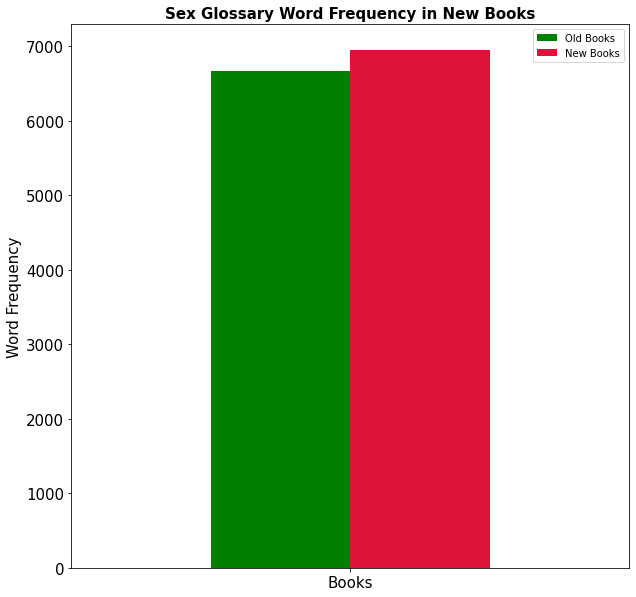

In [2297]:
# compare frequency word distribution between old books and new books

x_vals = [tot_old_books]
y_vals = [tot_new_books]
index = ['Books']

df = pd.DataFrame({'Old Books':x_vals, 'New Books':y_vals}, index = index)
plot_freq = df.plot.bar(figsize = (10,10), rot=0, stacked = False, fontsize = '15', color = {"Old Books": "green", "New Books": "crimson"})

plt.title('Sex Glossary Word Frequency in New Books', fontweight='bold', fontsize = '15')
    
#Add x and y labels
plt.ylabel('Word Frequency', fontsize = '15')
plt.legend()
plt.show()

Despite being 39% shorter, the newer books had more words that appeared in the sex glossary.

### Word Clouds

To analyze which parts of the texts I wanted to dive in deeper, I produced word clouds that showed which words were most common in each text (modern & old) according to the sex glossary filter.

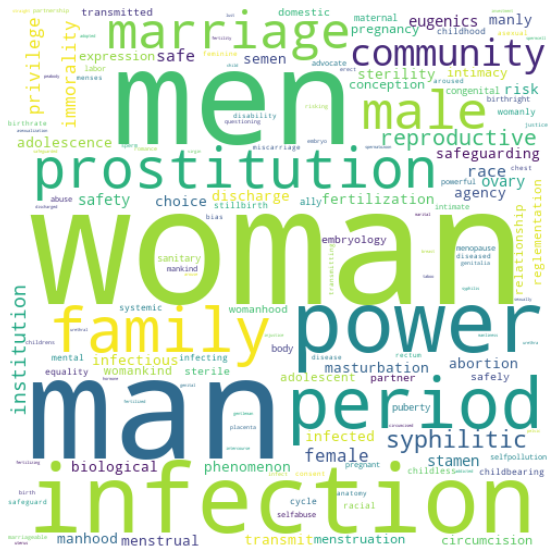

In [2289]:
#old books
data = o.set_index('Word').to_dict()['Frequency']
old_wc = WordCloud(width=500, height=500, max_words=500, background_color = 'white').generate_from_frequencies(data)
plt.figure(figsize=(10, 10))
plt.imshow(old_wc, interpolation='bilinear')
plt.axis('off')
plt.show()

Older text focused more on both men & women, family, power, infections, and sexual-purity words such as "prostitution" and "immorality".

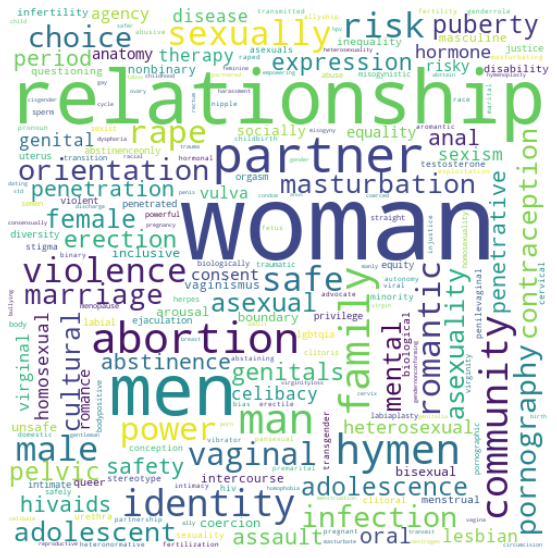

In [2020]:
#new books
data = n.set_index('Word').to_dict()['Frequency']
new_wc = WordCloud(width=500, height=500, max_words=500, background_color = 'white').generate_from_frequencies(data)
plt.figure(figsize=(10, 10))
plt.imshow(new_wc, interpolation='bilinear')
plt.axis('off')
plt.show()

Newer text seemed to be more even on sexual health topics. They focused more on women, relationships, anatomy, and words related to agency such as "violence", "community", and "safe".

In [2024]:
print(sex_glossary)

['abort', 'ableism', 'ableist', 'abstain', 'abstinen', 'abuse', 'abusive', 'addict', 'adolescen', 'adopt', 'advocate', 'afterbirth', 'agency', 'agender', 'aids', 'ally', 'anal', 'anatomy', 'androgen', 'androgynous', 'anus', 'asexual', 'areola', 'arous', 'assault', 'autonomy', 'bdsm', 'bias', 'bigender', 'binary', 'biological', 'biopsy', 'biphob', 'birth', 'bisexual', 'body', 'boner', 'boundar', 'breast', 'bully', 'c-section', 'celiba', 'cervical', 'cervix', 'chest', 'child', 'chlmaydia', 'choice', 'circumcis', 'cis', 'classis', 'clitoris', 'community', 'coerc', 'conception', 'condom', 'consent', 'contraception', 'contraceptive', 'cultural', 'cum', 'cycle', 'dating', 'disab', 'discharge', 'disease', 'diversity', 'domestic', 'drag', 'dysphoria', 'ejaculat', 'embryo', 'endometriosis', 'epidural', 'equality', 'equity', 'erect', 'erotic', 'estrogen', 'eugenics', 'exploit', 'expression', 'family', 'fatphob', 'female', 'feminin', 'feminis', 'fertil', 'fetus', 'foreplauy', 'foreskin', 'gasligh

From the sex glossary, I built a new glossary that focuses on marginalized identities and filtered the text according to it.

In [2034]:
# compare frequency word distribution between old books and new books: marginalized identities
marginalized = ['ableism', 'ableist', 'advocate', 'agency', 'agender', 'ally', 'asexual', 'bigender', 'binary', 'biphob', 'bisexual', 'bully', 'classis', 'community', 'cultural', 'disab', 'diversity', 'dysphoria', 'equality', 'equity', 'fatphob', 'female', 'feminin', 'feminis', 'gay', 'gender', 'homo', 'identity', 'inclus', 'intersectional', 'intersex', 'justice', 'lesbian', 'lgbtq', 'nonbinary', 'nonconforming', 'pansexual', 'queer', 'questioning','race', 'racial', 'racism', 'sexis', 'transition', 'transgender', 'woman', 'women']

mar_old_books = filter(df_old_books, marginalized, irrelevant)
mar_new_books = filter(df_new_books, marginalized, irrelevant)

mar_tot_old = mar_old_books['Frequency'].sum()
mar_tot_new = mar_new_books['Frequency'].sum()

print(mar_tot_old)
print(mar_tot_new)

920
1672


In [2]:
1 - 920/1672

0.44976076555023925

While the older texts are 39% longer, the modern texts had 45% more frequent words that appear in the marginalized identities glossary.

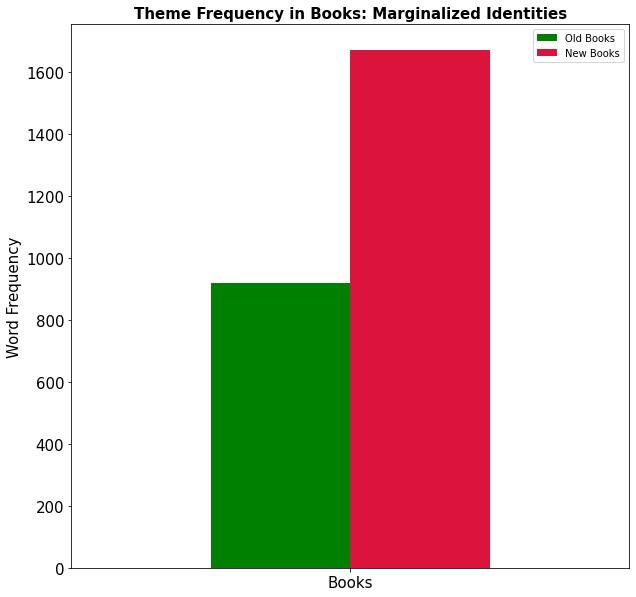

In [2296]:
x_vals = [mar_tot_old ]
y_vals = [mar_tot_new ]
index = ['Books']

df = pd.DataFrame({'Old Books':x_vals, 'New Books':y_vals}, index = index)
plot_freq = df.plot.bar(figsize = (10,10), rot=0, stacked = False, fontsize = '15', color = {"Old Books": "green", "New Books": "crimson"})

plt.title('Theme Frequency in Books: Marginalized Identities', fontweight='bold', fontsize = '15')
    
#Add x and y labels
plt.ylabel('Word Frequency', fontsize = '15')
plt.legend()
plt.show()

From the sex glossary, I built a new glossary that focuses on anatomy and filtered the text according to it.

In [2035]:
# compare frequency word distribution between old books and new books: anatomy
anatomy = ['afterbirth', 'anatomy', 'androgen', 'androgynous', 'anus', 'areola', 'biological', 'biopsy', 'birth', 'body', 'boner', 'breast', 'c-section', 'cervical', 'cervix', 'chest', 'circumcis', 'clitoris', 'cum', 'discharge', 'ejaculat', 'embryo', 'erect', 'estrogen', 'fetus', 'foreskin', 'genital', 'gonads', 'hymen', 'intercourse', 'labia', 'labor', 'masturbat', 'menorrhagia', 'menses', 'menstrual', 'miscarriage', 'nipple', 'orgasm', 'ovar', 'ovulat', 'pelvic', 'penetrat', 'penis', 'period', 'phallic', 'pheromon', 'placenta', 'premenstrual', 'pregnan', 'progestorone', 'prostate', 'puberty', 'rectum',  'reproductive', 'scrotum', 'sperm', 'testes', 'testicles', 'testosterone', 'urethra', 'uterus', 'vaginismus', 'vaginitis', 'vulva', 'zygote']

ana_old_books = filter(df_old_books, anatomy, irrelevant)
ana_new_books = filter(df_new_books, anatomy, irrelevant)

ana_tot_old = ana_old_books['Frequency'].sum()
ana_tot_new =ana_new_books['Frequency'].sum()

print(ana_tot_old)
print(ana_tot_new)

1074
1210


In [3]:
1-1074/1210

0.11239669421487608

While the older texts are 39% longer, modern texts had 11% more frequent words that appear in the anatomy glossary.

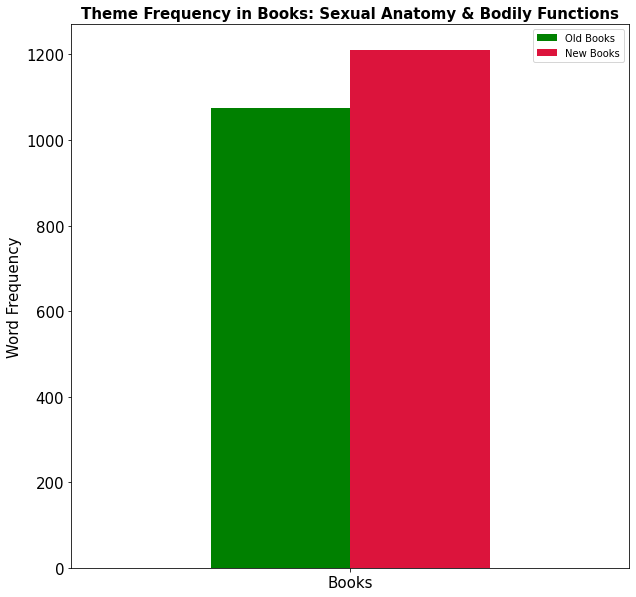

In [2295]:
x_vals = [ana_tot_old ]
y_vals = [ana_tot_new ]
index = ['Books']

df = pd.DataFrame({'Old Books':x_vals, 'New Books':y_vals}, index = index)
plot_freq = df.plot.bar(figsize = (10,10), rot=0, stacked = False, fontsize = '15', color = {"Old Books": "green", "New Books": "crimson"})

plt.title('Theme Frequency in Books: Sexual Anatomy & Bodily Functions', fontweight='bold', fontsize = '15')
    
#Add x and y labels
plt.ylabel('Word Frequency', fontsize = '15')
plt.legend()
plt.show()

From the sex glossary, I built a new glossary that focuses on sexual purity, disease, and violence, then filtered the text according to it.

In [2041]:
# compare frequency word distribution between old books and new books: sexual purity, disease, and violence
disease = ['abstain', 'abstinen', 'abuse', 'abusive', 'addict', 'aids', 'assault', 'chlmaydia', 'disease', 'exploit', 'gaslight', 'gonad', 'gonhorrea', 'harass', 'herpes', 'hiv', 'hpv', 'infect', 'lust', 'promiscuous', 'risk', 'sanitary', 'sodomy', 'std', 'stereotype', 'steril', 'stigma', 'syphil', 'taboo', 'traffick', 'transmit', 'uti', 'violen', 'virgin']

dis_old_books = filter(df_old_books, disease, irrelevant)
dis_new_books = filter(df_new_books, disease, irrelevant)

dis_tot_old = dis_old_books['Frequency'].sum()
dis_tot_new = dis_new_books['Frequency'].sum()

print(dis_tot_old)
print(dis_tot_new)

1729
797


In [4]:
1-797/1729

0.5390399074609601

While the older texts are only 39% longer, they had 54% more frequent words that appeared in the sexual purity & disease glossary than the modern texts.

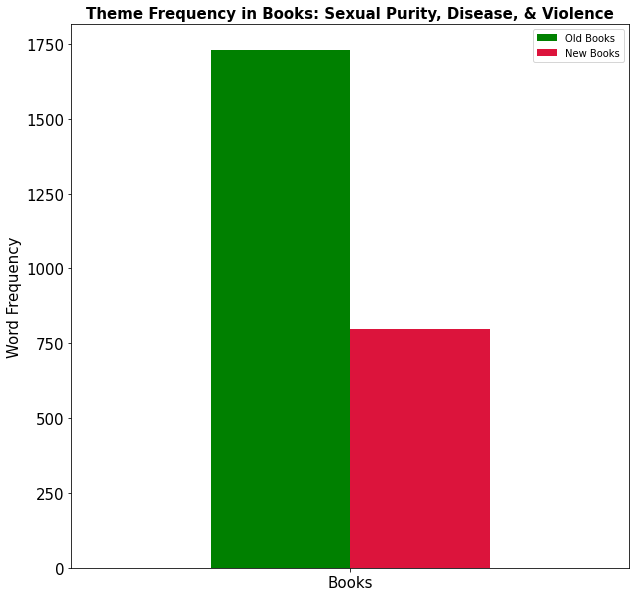

In [2294]:
x_vals = [dis_tot_old ]
y_vals = [dis_tot_new ]
index = ['Books']

df = pd.DataFrame({'Old Books':x_vals, 'New Books':y_vals}, index = index)
plot_freq = df.plot.bar(figsize = (10,10), rot=0, stacked = False, fontsize = '15', color = {"Old Books": "green", "New Books": "crimson"})

plt.title('Theme Frequency in Books: Sexual Purity, Disease, & Violence', fontweight='bold', fontsize = '15')
    
#Add x and y labels
plt.ylabel('Word Frequency', fontsize = '15')
plt.legend()
plt.show()

### TF-IDF

In the following section, I analyze the TF-IDF scores of the modern texts and the older texts.

In [2351]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

In [2358]:
vintage1 = open("WhatAYoungManOughtToKnow1897.txt", encoding = 'utf-8').read()
vintage2 = open("SexHygiene1913.txt", encoding = 'utf-8').read() 
vintage3 = open("HighSchoolsSexEducation1922.txt", encoding = 'utf-8').read()

modern1 = open("SexEducationForBoys2022.txt", encoding = 'utf-8').read() 
modern2 = open("LosingIt2022.txt", encoding = 'utf-8').read() 
modern3 = open("HumanSexualityLessonPlans.txt", encoding = 'utf-8').read() 

vintage = vintage1 + vintage2 + vintage3
modern = modern1+ modern2+ modern3

print(vintage)

22500275458 



r 



CommenDa* 
twits from : 
Cmtnent : : 
^cn attD : : 
domett : : 



What Eminent Profit in Ambrica Sat, 




JOSEPH COOK, D.D., LL.D. 

The Eminent Scholar; Boston Monday Lecturer; 
author of " Biology," " Marriage," " Labor," 
" Socialism," " Occident," " Orient," etc. 

" Vour book on ' What a Young Boy Ought to 
Know ' treats its subject with the utmost delicacy 
and lucidity and is severely faithful in its admonitions 
to parents as well as to the young. It is everywhere 
suggestive, inspiring, and strategic in a degree, as I 
think, not hitherto matched in literature of its class. 
Its wide circulation ought to fall on the hearts of the 
young in their thrifty and jubilant vernal season as a 
divine benediction of light and heat and rain." 



What Eminent I»e oi >i.h3 ij* America Sat. 




THEODORE L. CUYLER, D.D. 

The best living writer of devotional literature ; former 
pastor of Lafayette Avenue Church, Brooklyn ; author 
of "Christianity in the Home," "H

In [2359]:
corpus = [vintage, modern]
cv = CountVectorizer()
cv_dtm = cv.fit_transform(corpus)
print(cv_bow)


  (0, 305)	1
  (0, 3547)	1
  (0, 17267)	1
  (0, 7115)	916
  (0, 3419)	1
  (0, 3420)	1
  (0, 1823)	1
  (0, 5334)	1
  (0, 18292)	381
  (0, 5761)	16
  (0, 13156)	4
  (0, 8546)	4378
  (0, 1317)	1
  (0, 14624)	8
  (0, 9400)	3
  (0, 4035)	1
  (0, 10025)	7
  (0, 16667)	14979
  (0, 14699)	2
  (0, 2469)	6
  (0, 10871)	1
  (0, 9782)	6
  (0, 1882)	43
  (0, 11558)	9901
  (0, 2300)	54
  :	:
  (1, 8152)	1
  (1, 4610)	1
  (1, 13697)	1
  (1, 16394)	1
  (1, 17606)	1
  (1, 13817)	1
  (1, 5296)	1
  (1, 7755)	1
  (1, 5101)	1
  (1, 9716)	1
  (1, 2564)	1
  (1, 819)	1
  (1, 7228)	1
  (1, 6425)	1
  (1, 6168)	1
  (1, 7454)	1
  (1, 2878)	1
  (1, 15312)	1
  (1, 11540)	1
  (1, 13873)	1
  (1, 11428)	1
  (1, 11188)	1
  (1, 7068)	1
  (1, 3908)	1
  (1, 16093)	1


In [2360]:
dtm = pd.DataFrame(cv_dtm.toarray(), columns=cv.get_feature_names_out())

print(dtm.shape)

dtm.head()

(2, 18713)


,00,000,002,01,010,015,016,02,03,04,044,05,050,0500,06,063,0632,08,085,09,090,0c,10,100,1000,10007,10036,101,1016,102,1022,103,1032,1033,104,104539,105,106,107,1076,108,109,10j,11,110,111,112,11219,113,114,1149,115,11501,116,117,11768,11775,118,119,12,120,1204,121,12109,122,123,124,125,12520,126,12671,127,128,129,12a,12th,13,130,131,132,133,134,135,136,137,13768,138,1380,139,13th,14,140,141,142,143,144,145,146,147,1478,148,149,1497,14th,15,150,150177,150t,151,1512,152,15229,153,1532,154,155,156,157,1573,158,159,16,160,161,162,163,164,165,166,1661,167,168,169,1698,16th,17,170,1708,171,172,173,174,175,176,177,17745,178,179,17a,18,180,181,1810,182,183,184,185,18580,186,1862,187,1872,1876,188,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,189,1890,1891,1892,1893,1894,1895,1896,1897,1898,1899,18s0,19,190,1900,1901,1902,1903,1904,1905,1906,1907,1908,1909,191,1910,1911,1912,1913,1914,1915,1916,1917,1918,1919,192,1920,1921,1922,19225,193,1930s,1933,1935,194,1946,195,1955,196,197,1970,1976,198,199,1992,1993,1994,1995,1998,1999,19a,1evelopment,1st,20,200,2000,2000s,2001,2002,2003,2004,2005,2007,2008,2009,201,2010,2010s,2011,20113,2012,2013,2014,2015,2016,2017,2018,2019,202,2020,2020s,2021,2022,2026,2027,203,2030,204,20475255,205,206,207,208,2085,20854,2088,209,20s,20th,21,210,212,213,214,215,216,217,2176,218,219,21st,22,220,221,221a,222,223,2237,224,2244,225,22500275458,226,227,2274,228,229,22977,22s,22year,23,230,23038,231,232,232363,233,235,236,2378,238,239,24,240,241,242,243,244,245,246,247,248,249,25,250,251,252,253,254,255,256,257,258,259,25l,25minutes,25s,26,260,261,26101,262,263,264,2640,265,266,2665,267,268,27,270,271,272,273,274,275,276,277,278,279,28,280,281,282,284,286,289,29,290,291,2914,293,293372,2934,296,297,298,299,29s,2g,2j,2nd,2q,2x1,2zz,30,300,301,3015,302,30249,303,3031,304,305,306,307,308,309,30s,31,310,311,3110,312,313,314,315,316,317,318,319,31911,32,321,323,328,329,33,330,333,335,3356,336,34,342,343,344,345,348,35,350,353,354,3555,36,3604,363,365,36536,37,370,3709,372,38,380,38041,382,384,385,388,389,39,392,39450,396,39620,3cx,3d,3ii,3x8,40,400,408,41,416,41690,418,41st,42,420,42420,4295,42nd,43,431,435,436,439,44,44083,447,448,45,450,452,4520,453,455,456,4576,458,46,460,461,4681,47,476,48,485,49,498,499,4cx,4e3,4s,50,500,501,503,505,506,50984,50c,51,510,511,517,52,521,523,525,528,53,533,534,535,538,54,542,543,544,55,550,554,55550,557,559,56,57,58,582,583411,5861,589,59,598,5fcavfc,5p,60,600,606,607,61,614,617,62,621,625,629,63,630,633,63807,64,6451,649,65,650,652,654,66,665,67,673,679,68,685,686,69,694,697,6d,6l,6o6,6r,70,700,704,709,71,714,72,720,721,723,724,729,73,731,733,735,738,74,743,7434,744,75,753,76,77,771,775,78,79,799,7th,80,800,807,81,819,82,822,83,830,832,84,840,841,844,846,85,86,861,865,866,869,87,872,88,885,889,89,8910,897,8i,8oo,90,900,9003,90s,91,914,9188,9191,9197,92,922,93,9371,939,94,945,94501,94612,948,95,951,95287,953,9537,9546,95a,95b,95feb,95i,95insuring,95jie,95m,95the,96,960,9618,969,97,973,978,9780008475581,9780008475604,98,981,99,9955,9959,996,9gf,___,____,_________,__________,a3,a332667,a35,a5,a6i,a7,a7g,a9ci,a9n,aa6,aada,aao,aaron,ab,ab3,ab30,ab3i,ab5,ab7,ab8ratws,aban,abandoned,abandoning,abate,abated,abba,abbey,abc,abdomen,abdomens,abdominal,abduction,abdulcadir,abel,abels,abeyance,abf,abhorrent,abide,abiding,abierta,abigail,abihty,abil,abilities,ability,abir,abject,abl,able,abled,ableist,ably,abnormal,aboard,abohshment,abolished,abolition,abort,aborted,abortion,abortions,abounding,about,abov,above,abrasive,abroad,abroromantic,abrupt,abruptly,abs4,abscess,abscesses,absence,absent,absokitely,absolute,absolutely,absorb,absorbable,absorbed,absorbent,absorbing,absorbs,absorption,abstain,abstained,abstainers,abstaining,absten,abstention,abstinence,abstract,absurd,absurdities,abu,abundance,abundant,abundantly,abuse,abused,abuser,abusers,abuses,abusive,abvi,abyss,ac,academic,academicaly,academics,academy,accept,acceptable,acceptance,accepted,accepting,accepts,access,accessed,accessible

In [2361]:
dtm.sum().sort_values(ascending=False).head(100)

the          19458
of           12738
and          12309
to            8859
in            6303
that          4409
is            3800
be            2772
for           2726
or            2698
it            2630
as            2543
are           2279
with          2184
you           1887
have          1736
sex           1714
not           1706
by            1636
this          1596
they          1372
on            1363
their         1323
from          1321
will          1229
an            1142
which         1127
he            1111
one           1101
but           1063
can           1047
all           1042
if            1012
your           973
at             971
his            969
her            950
has            902
what           877
we             853
about          847
who            843
there          838
boy            827
more           799
these          775
may            771
when           745
sexual         737
women          737
them           712
she            704
life        

In [2372]:
dtm.mean().sort_values(ascending=False).head(100)

the          9729.0
of           6369.0
and          6154.5
to           4429.5
in           3151.5
that         2204.5
is           1900.0
be           1386.0
for          1363.0
or           1349.0
it           1315.0
as           1271.5
are          1139.5
with         1092.0
you           943.5
have          868.0
sex           857.0
not           853.0
by            818.0
this          798.0
they          686.0
on            681.5
their         661.5
from          660.5
will          614.5
an            571.0
which         563.5
he            555.5
one           550.5
but           531.5
can           523.5
all           521.0
if            506.0
your          486.5
at            485.5
his           484.5
her           475.0
has           451.0
what          438.5
we            426.5
about         423.5
who           421.5
there         419.0
boy           413.5
more          399.5
these         387.5
may           385.5
when          372.5
sexual        368.5
women         368.5


In [2373]:
stop = stopwords.words('english')
tfidfvec = TfidfVectorizer(min_df=2,lowercase=True,stop_words=stop)

In [2374]:
tfidf = tfidfvec.fit_transform(corpus)
print(tfidf)

  (0, 630)	0.0003087853471653885
  (0, 2865)	0.000617570694330777
  (0, 2173)	0.0003087853471653885
  (0, 2059)	0.0009263560414961655
  (0, 1600)	0.0003087853471653885
  (0, 881)	0.0003087853471653885
  (0, 571)	0.0003087853471653885
  (0, 3263)	0.0003087853471653885
  (0, 1094)	0.0003087853471653885
  (0, 577)	0.0003087853471653885
  (0, 2881)	0.0003087853471653885
  (0, 221)	0.0003087853471653885
  (0, 4579)	0.0003087853471653885
  (0, 3535)	0.0003087853471653885
  (0, 2894)	0.000617570694330777
  (0, 2658)	0.0003087853471653885
  (0, 1156)	0.0003087853471653885
  (0, 1481)	0.0009263560414961655
  (0, 4304)	0.0003087853471653885
  (0, 2954)	0.0003087853471653885
  (0, 741)	0.0003087853471653885
  (0, 4845)	0.0003087853471653885
  (0, 3083)	0.0003087853471653885
  (0, 1740)	0.0003087853471653885
  (0, 1865)	0.000617570694330777
  :	:
  (1, 4515)	0.07123321478011367
  (1, 1263)	0.004245688298152471
  (1, 4303)	0.0004717431442391634
  (1, 2429)	0.0009434862884783268
  (1, 4372)	0.000471

In [2375]:
tfidf = pd.DataFrame(tfidf.toarray(), columns=tfidfvec.get_feature_names_out())

In [2376]:
tfidf.max().sort_values(ascending=False).head(20)

sex        0.393906
sexual     0.309935
boy        0.245176
one        0.213371
women      0.201906
upon       0.168906
people     0.165582
life       0.164274
may        0.161186
men        0.147656
girl       0.144203
like       0.143410
boys       0.142968
many       0.141424
son        0.141051
time       0.141051
young      0.129381
disease    0.125058
must       0.122588
man        0.122279
dtype: float64

In [2377]:

tfidf = tfidf.drop(tfidf.columns[[np.arange(0,175)]], axis = 1)

/Users/meganetchatchouang/opt/anaconda3/lib/python3.9/site-packages/pandas/core/indexes/base.py:5055: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  result = getitem(key)


In [2388]:
tfidf.loc[-1,:] = tfidf.columns
tfidf.index += 1
tfidf.sort_index(inplace = True)
tfidf.columns=[np.arange(0, len(tfidf.columns))]
tfidf

0          1         2         3          4          5         6     \
0      (0,)       (1,)      (2,)      (3,)       (4,)       (5,)      (6,)   
1     aaron  abandoned       abc   abdomen  abdominal  abilities   ability   
2  0.000309   0.001853  0.000618  0.001235   0.001853   0.000309  0.005249   
3  0.000472   0.000472  0.000472  0.000943   0.000472   0.001415  0.011322   

       7         8         9          10        11        12        13    \
0      (7,)      (8,)      (9,)      (10,)     (11,)     (12,)     (13,)   
1      able  abnormal  abortion  abortions    abroad   absence    absent   
2  0.011425  0.002161  0.002161   0.004941  0.002161  0.005558  0.001235   
3  0.028776  0.000943  0.040098   0.004717  0.001415  0.003774  0.000943   

       14          15        16        17        18          19          20    \
0     (14,)       (15,)     (16,)     (17,)     (18,)       (19,)       (20,)   
1  absolute  absolutely    absorb  absorbed   abstain  abstention  abstinence   
2  0.001544    0.003088  0.000618  0.000309  0.000309    0.000309    0.000309   
3  0.001887    0.002359  0.000472  0.001887  0.003302    0.000943    0.012265   

       21        22        23        24        25          26        27    \
0     (21,)     (22,)     (23,)     (24,)     (25,)       (26,)     (27,)   
1    absurd     abuse    abused   academy    accept  acceptable  accepted   
2  0.000309  0.006176  0.000309  0.000309  0.002161    0.000618  0.003088   
3  0.000472  0.015568  0.001887  0.000472  0.003774    0.004246  0.000943   

        28        29          30          31           32              33    \
0      (28,)     (29,)       (30,)       (31,)        (32,)           (33,)   
1  accepting    access  accessible  accidental  accompanies  accomplishment   
2   0.000618  0.000926    0.000618    0.000926     0.000309        0.000926   
3   0.006133  0.022172    0.000943    0.000943     0.000472        0.000943   

       34          35         36           37       38        39    \
0     (34,)       (35,)      (36,)        (37,)    (38,)     (39,)   
1    accord  accordance  according  accordingly  account  accounts   
2  0.001853    0.000618   0.004014     0.001235  0.01019  0.000309   
3  0.000472    0.000943   0.007076     0.000472  0.00283  0.002359   

          40            41        42        43          44        45    \
0        (40,)         (41,)     (42,)     (43,)       (44,)     (45,)   
1  accumulated  accumulation  accuracy  accurate  accurately      ache   
2     0.000618      0.000309   0.00247  0.007102    0.002161  0.000309   
3     0.000472      0.000472  0.000472  0.008491    0.000472  0.000472   

       46        47            48           49            50            51    \
0     (46,)     (47,)         (48,)        (49,)         (50,)         (51,)   
1   achieve  achieved  achievements  acknowledge  acknowledges  acquaintance   
2  0.000309  0.000309      0.000309     0.002161      0.000309      0.003397   
3   0.00283  0.000472      0.000472     0.003774      0.000472      0.000943   

            52        53        54         55        56        57        58    \
0          (52,)     (53,)     (54,)      (55,)     (56,)     (57,)     (58,)   
1  acquaintances   acquire  acquired  acquiring    across       act     acted   
2       0.000618  0.004632  0.006484   0.000618  0.000309  0.008028  0.000309   
3       0.001887  0.000943  0.000943   0.002359  0.015096  0.013209  0.001415   

       59        60        61        62        63        64          65    \
0     (59,)     (60,)     (61,)     (62,)     (63,)     (64,)       (65,)   
1    acting    action   actions  activate    active  actively  activities   
2  0.000926  0.008028  0.000926  0.000309  0.014513   0.00247    0.012969   
3  0.003302  0.006604  0.008491  0.000472  0.014624  0.006604    0.011794   

       66        67        68        69        70        71        72    \
0     (66,)     (67,)     (68,)     (69,)     (70,)     (

In [2389]:
tfidf_old = tfidf.transpose().drop(columns = [0,3], inplace = False, axis = 1)
tfidf_old = tfidf_old.rename(columns = {1:"Word", 2: "TF-IDF"}).sort_values('TF-IDF', ascending=False)
tfidf_old

,Word,TF-IDF
3865,sex,0.271422
498,boy,0.245176
2927,one,0.213371
4559,upon,0.168906
2490,life,0.164274
2641,may,0.161186
1873,girl,0.144203
499,boys,0.142968
2608,many,0.141424
4800,young,0.129381


In [2390]:
fil_tfidf_old = filter(tfidf_old, sex_glossary, irrelevant)
fil_tfidf_old

,Word,TF-IDF
1226,disease,0.125058
2595,man,0.122279
664,child,0.11178
2671,men,0.107457
667,children,0.105605
479,body,0.096959
4750,women,0.095415
1227,diseases,0.084607
4257,syphilis,0.077814
4747,woman,0.071947


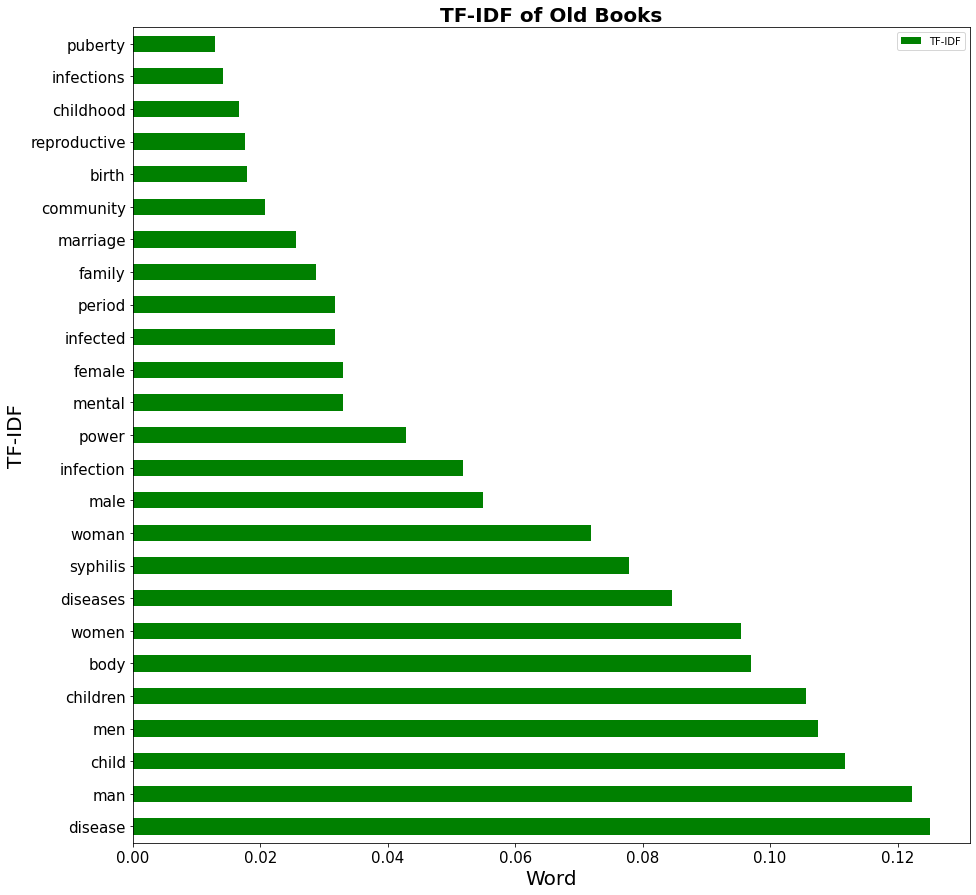

In [2380]:
x_vals = fil_tfidf_old['Word'].head(25)
y_vals = fil_tfidf_old['TF-IDF'].head(25)

df = pd.DataFrame({'Word':x_vals, 'TF-IDF':y_vals})
plot_freq = df.plot.barh(x = 'Word',
                             y='TF-IDF',
                             figsize = (15,15),
                             color = 'green')

plt.title('TF-IDF of Old Books', fontweight='bold', fontsize = '20')
    
#Add x and y labels
plt.xlabel('Word', fontsize = '20')
plt.xticks(fontsize=15)
plt.ylabel('TF-IDF', fontsize = '20')
plt.yticks(fontsize=15)
plt.legend()
plt.show()

In older text, the words "disease", "man"/"men", and "child"/"children" held the most importance.

In [2393]:
tfidf_new = tfidf.transpose().drop(columns = [0,2], inplace = False, axis = 1)
tfidf_new = tfidf_new.rename(columns = {1:"Word", 3: "TF-IDF"}).sort_values('TF-IDF', ascending=False)
tfidf_new

,Word,TF-IDF
3865,sex,0.393906
3869,sexual,0.309935
4750,women,0.201906
2927,one,0.193415
3063,people,0.165582
2671,men,0.147656
2497,like,0.14341
3999,son,0.141051
4369,time,0.141051
2641,may,0.117464


In [2394]:
fil_tfidf_new = filter(tfidf_new, sex_glossary, irrelevant)
fil_tfidf_new

,Word,TF-IDF
4750,women,0.201906
2671,men,0.147656
3538,relationships,0.084914
3537,relationship,0.081612
864,consent,0.071705
2592,male,0.058496
4747,woman,0.058024
479,body,0.055666
1666,female,0.051892
3364,puberty,0.047646


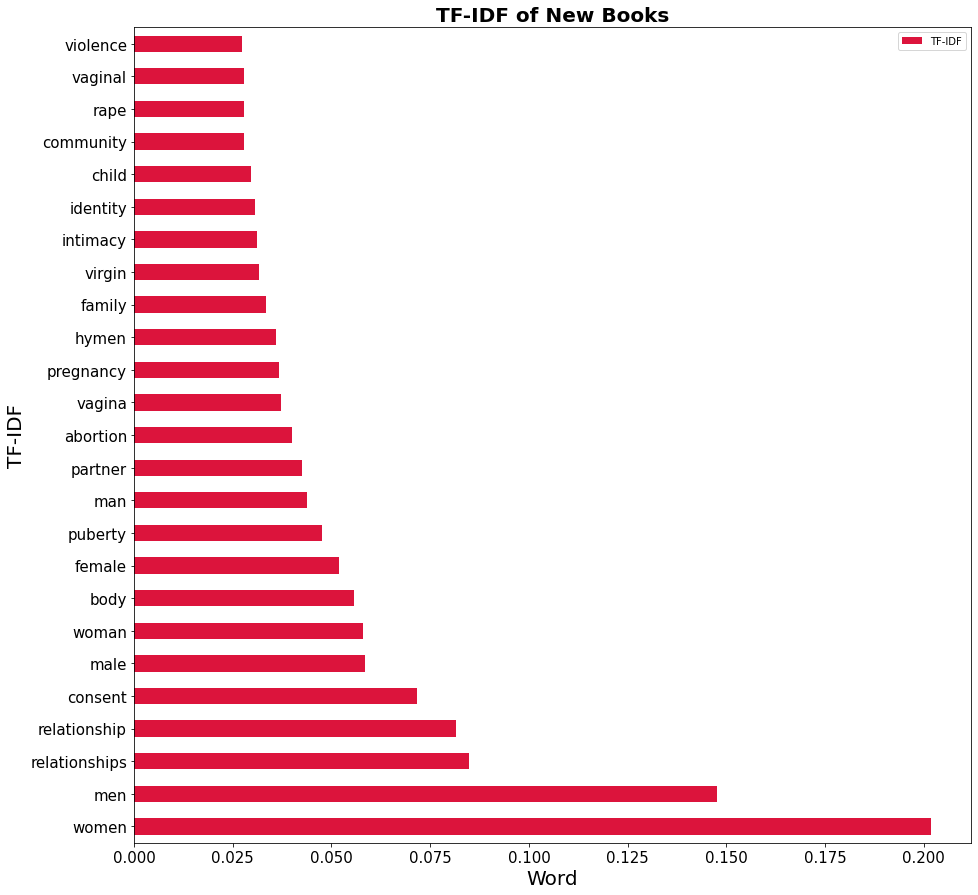

In [2395]:
x_vals = fil_tfidf_new['Word'].head(25)
y_vals = fil_tfidf_new['TF-IDF'].head(25)

df = pd.DataFrame({'Word':x_vals, 'TF-IDF':y_vals})
plot_freq = df.plot.barh(x = 'Word',
                             y='TF-IDF',
                             figsize = (15,15), color = "crimson")

plt.title('TF-IDF of New Books', fontweight='bold', fontsize = '20')
    
#Add x and y labels
plt.xlabel('Word', fontsize = '20')
plt.xticks(fontsize=15)
plt.ylabel('TF-IDF', fontsize = '20')
plt.yticks(fontsize=15)
plt.legend()
plt.show()

In modern text, the word "women" was more important than "men" in comparison to older text. Other important words include "relationship(s)", "consent", and "body. 

### Sentiment Analysis

Finally, I performed a sentiment analysis on the texts to analyze their tone. 

In [2407]:
sent_old_book1 = sia.polarity_scores(vintage1)
sent_old_book2 = sia.polarity_scores(vintage2)
sent_old_book3 = sia.polarity_scores(vintage3)
sent_old_books = sia.polarity_scores(vintage)

sent_new_book1 = sia.polarity_scores(modern1)
sent_new_book2 = sia.polarity_scores(modern2)
sent_new_book3 = sia.polarity_scores(modern3)
sent_new_books = sia.polarity_scores(modern)

In [2410]:
old_sentiments = pd.DataFrame.from_dict({'WAYMOTK':sent_old_book1, 'TEOTYISH':sent_old_book2, 'HSSE':sent_old_book3, 'Old Books':sent_old_books})
old_sentiments = old_sentiments.head(3)
old_sentiments

,WAYMOTK,TEOTYISH,HSSE,Old Books
neg,0.084,0.086,0.052,0.08
neu,0.753,0.792,0.825,0.79
pos,0.163,0.122,0.123,0.13


In [2411]:
new_sentiments = pd.DataFrame.from_dict({'SEFB':sent_new_book1, 'LI':sent_new_book2, 'HSLP':sent_new_book3, 'New Books':sent_new_books})
new_sentiments = new_sentiments.head(3)
new_sentiments

,SEFB,LI,HSLP,New Books
neg,0.071,0.085,0.083,0.079
neu,0.752,0.802,0.802,0.787
pos,0.177,0.113,0.115,0.134


Overall, the modern texts had a slightly more positive/less negative tone than the older texts.

# Conclusion

My findings center around the fact that modern texts were performed a lot better in progressive sexual health education. While this was true, I was surprised to see that the difference in sentiments weren't too noticeable between the two, especially because older texts seemed to focus a lot on sexual purity and disease. If I had more time and resources, I would:
- performed a sentiment analysis through another library
- adapted the texts to similar linguistic styles to account for the difference in language over the years
- created a more comprehensive process for choosing the words in the sex glossary
- clean up text to ensure that there weren't any random, misspelled words
- created an algorithm similar to lemmatization to further groupp similar words together such as "woman" & "women"
- researched for more textual data, including by comparing differences in sexual health education by varying regions

As the project implies, these days, we have plenty of resources we can leverage to teach comprehensive sexual education to young children, even including suggested lesson plan. The question that is left to us is will we use it? We may be in 2022, but it wouln't come to a shock to us that different regions and different schools may be inclined to use texts from 1972 or even 1922, reflecting the ideas of those times rather than the progressives modern texts experts have built & organized. Hopefully, as time passes, sexual health education will not only be normalized, but also be comprehensive, highlighting various intersectional identities, topics surrounding consent & sexual agency, and proper knowledge of anatomy.